# **🐶📸 Projet MLOps – Classification des Races de Chiens**

## 🎯 <span style="color:#0099cc">Contexte</span>

Nous sommes bénévoles pour l'association **Agir pour les animaux**, une structure locale dédiée à la protection et au bien-être des chiens de notre quartier.  
Pour contribuer à leur cause avec nos compétences en **intelligence artificielle**, nous avons décidé de les accompagner techniquement.

En échangeant avec les membres de l’association, nous avons appris que :

- Leur base de données d’animaux 🐾 **s’agrandit chaque jour**.
- Ils possèdent des **milliers de photos de chiens non triées**.
- Le manque de temps rend difficile le **référencement manuel** des images par race.

> 👉 Une solution automatisée représenterait un **gain de temps considérable** pour l’équipe.

---

## ❓ <span style="color:#e67e22">Problématique</span>

Comment peut-on **automatiser la reconnaissance de la race d’un chien** à partir d’une simple image 📷 ?  
Et comment fournir aux bénévoles une **interface simple et rapide** pour tester ce modèle au quotidien ?

---

## 🎯 <span style="color:#2ecc71">Objectifs du Projet</span>

✅ Développer un **algorithme de classification d’images de chiens** par race  
✅ Suivre les **bonnes pratiques MLOps** : versionnement, traçabilité, expérimentation reproductible  
✅ Fournir une **API backend** connectée à notre application React permettant :
  - Le chargement d’une photo de chien 🐕
  - L’obtention de la race prédite + taux de confiance

✅ Mettre en place un **monitoring des performances** avec MLflow  
✅ Rendre le modèle évolutif (possibilité de ré-entraîner ou d’améliorer)

---

## 🧱 <span style="color:#9b59b6">Stack Technique</span>

| Élément                 | Technologie        |
|------------------------|--------------------|
| 📊 Entraînement modèle | TensorFlow / Keras |
| 🧪 Tracking             | MLflow             |
| 🧮 Modèles CNN          | MobileNet, VGG16   |
| 📦 API Backend         | FastAPI             |
| 🌐 Frontend            | React               |
| 📁 Dataset             | Images de chiens    |

---

## 🧠 <span style="color:#f1c40f">Pourquoi ce projet est important ?</span>

Ce projet est **utile, concret et porteur de sens** :

🐾 Il permet d’**aider une association** dans sa mission de protection animale  
💻 Il démontre la mise en œuvre **complète d’un projet IA** avec les outils MLOps  
🎓 Il constitue une **excellente formation pratique** pour les développeurs, ingénieurs ou étudiants

---

## 🚀 <span style="color:#3498db">Résultat attendu</span>

Nous visons une **application complète** capable de :
- Reconnaître automatiquement la race d’un chien à partir d’une photo
- Fournir une réponse rapide et compréhensible dans une interface React
- Aider l'association à **gagner du temps** tout en assurant la **qualité logicielle**, la traçabilité et la performance du modèle

---


In [1]:
pwd

'/Users/mar/Desktop/dog-breed-classifier/notebooks'

In [2]:
# ---------------------
# 🔁 Magics Jupyter
# ---------------------
%reload_ext autoreload
%autoreload 2

In [3]:
import sys
from pathlib import Path

PROJECT_ROOT = Path.cwd().parent
sys.path.insert(0, str(PROJECT_ROOT))

## 📦 Librairies standard

In [4]:
import os
import sys
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from datetime import datetime
from collections import Counter

## 🧪 Machine Learning / Deep Learning

In [5]:
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2, VGG16, DenseNet121
from tensorflow.keras.models import Model, Sequential, load_model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, BatchNormalization, Dropout
from tensorflow.keras.losses import SparseCategoricalCrossentropy
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img
from tensorflow.keras.metrics import Accuracy, AUC, Precision, Recall, SparseCategoricalAccuracy

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
from torchvision import models, transforms

from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score, log_loss, roc_curve, auc
)
from sklearn.preprocessing import LabelEncoder, LabelBinarizer, label_binarize
from sklearn.utils import shuffle

2025-07-29 12:21:29.777720: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


## 📋 Tracking avec MLflow

In [6]:
import mlflow
import mlflow.keras
import mlflow.pytorch
import logging
from mlflow import log_param, log_metric, log_artifacts
from mlflow.models import infer_signature
from mlflow.tracking import MlflowClient

## 🔧 Outils divers

In [7]:
import cv2
from tqdm import tqdm
from loguru import logger
import pendulum
from pyngrok import ngrok

## 🧩 Modules personnalisés

In [8]:
from settings.config import *
from src.make_dataset import *
from src.make_model_mobilenet import *
from src.make_model_vgg16 import *
from src.make_model_densenet import *

## Chargement et Prétraitement des données

### ⚙️ Settings

In [9]:
log_fmt = (
    "<green>{time:YYYY-MM-DD HH:mm:ss.SSS!UTC}</green> | "
    "<level>{level:<8}</level> | "
    "<cyan>{module}</cyan>:<cyan>{function}</cyan>:<cyan>{line}</cyan> - "
    "<level>{message}</level>"
)

logger.remove()  # Supprimer tous les anciens handlers pour éviter la duplication
logger.add(sys.stderr, format=log_fmt, level="INFO")

CURRENT_DATE = pendulum.now("UTC")

NOTEBOOKS_DIR = Path.cwd()
PROJECT_DIR = NOTEBOOKS_DIR.parent
SRC_DIR = PROJECT_DIR / "src"
DATA_DIR = PROJECT_DIR / "data"
REPORTS_DIR = PROJECT_DIR / "reports"

REPORTS_DIR.mkdir(parents=True, exist_ok=True)

logger.info(f"📁 Répertoire du projet : {PROJECT_DIR}")
logger.info(f"📁 Répertoire des rapports : {REPORTS_DIR}")
logger.info(f"📁 Répertoire source (src) : {SRC_DIR}")
logger.info(f"📁 Répertoire des données : {DATA_DIR}")
logger.info(f"📅 Date actuelle (UTC) : {CURRENT_DATE}")

2025-07-29 12:21:42.040 | INFO     | 3083845043:<module>:21 - 📁 Répertoire du projet : /Users/mar/Desktop/dog-breed-classifier
2025-07-29 12:21:42.041 | INFO     | 3083845043:<module>:22 - 📁 Répertoire des rapports : /Users/mar/Desktop/dog-breed-classifier/reports
2025-07-29 12:21:42.041 | INFO     | 3083845043:<module>:23 - 📁 Répertoire source (src) : /Users/mar/Desktop/dog-breed-classifier/src
2025-07-29 12:21:42.042 | INFO     | 3083845043:<module>:24 - 📁 Répertoire des données : /Users/mar/Desktop/dog-breed-classifier/data
2025-07-29 12:21:42.043 | INFO     | 3083845043:<module>:25 - 📅 Date actuelle (UTC) : 2025-07-29 12:21:42.039831+00:00


### Analyse des donnees

In [10]:
base_dir = '../data/images'

In [11]:
images, labels, class_names = load_data(base_dir)

Loading n02112137-chow: 100%|███████████████| 196/196 [00:00<00:00, 1105.65it/s]
Loading n02087394-Rhodesian_ridgeback: 100%|█| 172/172 [00:00<00:00, 1107.03it/s
Loading n02112706-Brabancon_griffon: 100%|██| 153/153 [00:00<00:00, 1049.49it/s]
Loading n02089078-black-and-tan_coonhound: 100%|█| 159/159 [00:00<00:00, 1240.28


In [12]:
class_names

['n02090622-borzoi',
 'n02113023-Pembroke',
 'n02113799-standard_poodle',
 'n02089973-English_foxhound',
 'n02085782-Japanese_spaniel',
 'n02086079-Pekinese',
 'n02113978-Mexican_hairless',
 'n02115913-dhole',
 'n02085936-Maltese_dog',
 'n02086646-Blenheim_spaniel',
 'n02088238-basset',
 'n02085620-Chihuahua',
 'n02090379-redbone',
 'n02090721-Irish_wolfhound',
 'n02088632-bluetick',
 'n02113712-miniature_poodle',
 'n02113186-Cardigan',
 'n02086910-papillon',
 'n02112137-chow',
 'n02087394-Rhodesian_ridgeback',
 'n02086240-Shih-Tzu',
 'n02087046-toy_terrier',
 'n02116738-African_hunting_dog',
 'n02111277-Newfoundland',
 'n02089867-Walker_hound',
 'n02088364-beagle',
 'n02111889-Samoyed',
 'n02088466-bloodhound',
 'n02112350-keeshond',
 'n02113624-toy_poodle',
 'n02111500-Great_Pyrenees',
 'n02088094-Afghan_hound',
 'n02115641-dingo',
 'n02112018-Pomeranian',
 'n02112706-Brabancon_griffon',
 'n02089078-black-and-tan_coonhound']

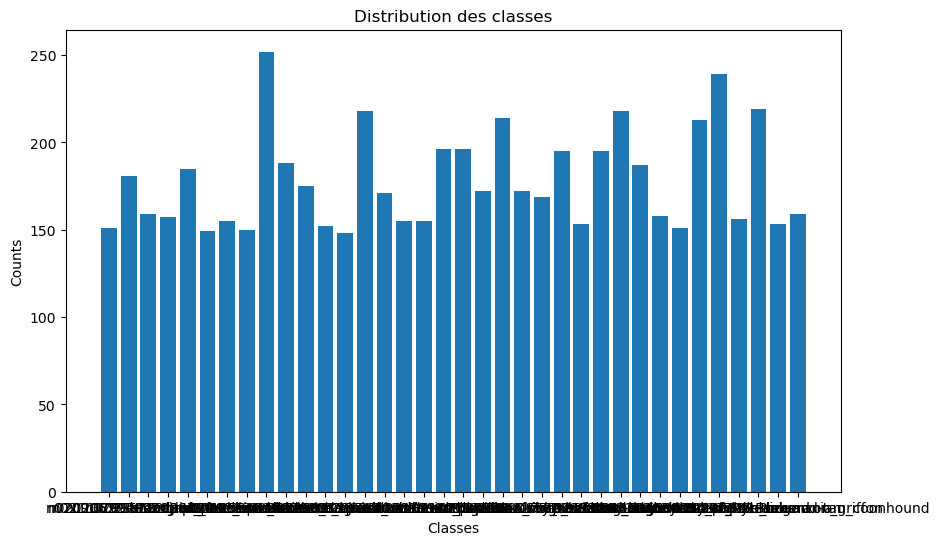

In [13]:
visualize_class_distribution(labels, class_names)

Images de: n02090622-borzoi


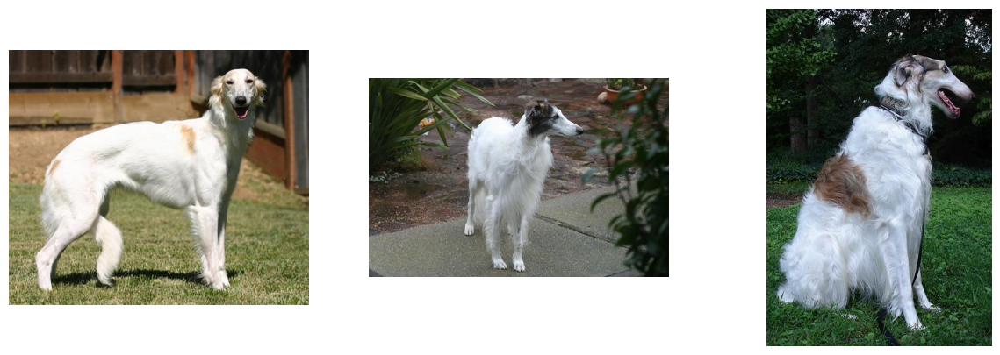

Images de: n02113023-Pembroke


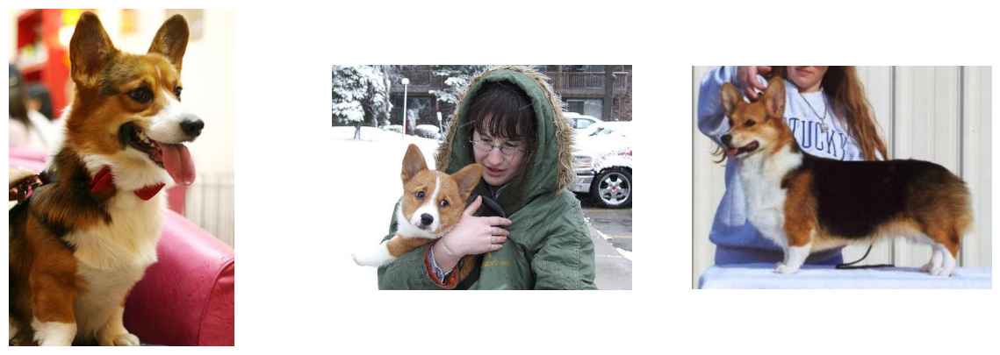

Images de: n02113799-standard_poodle


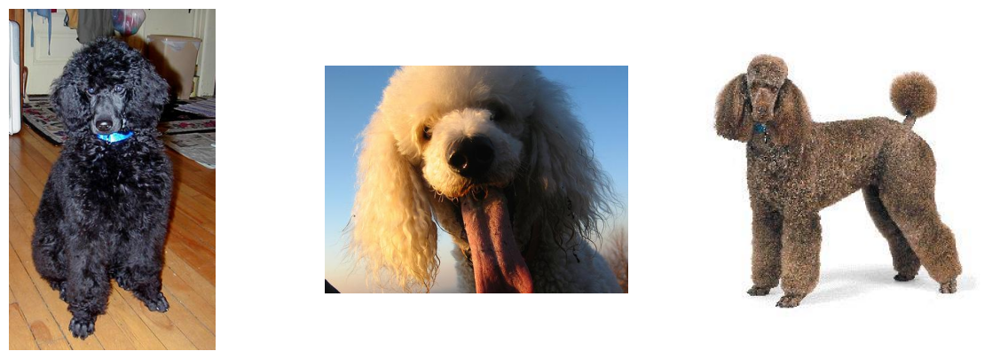

Images de: n02089973-English_foxhound


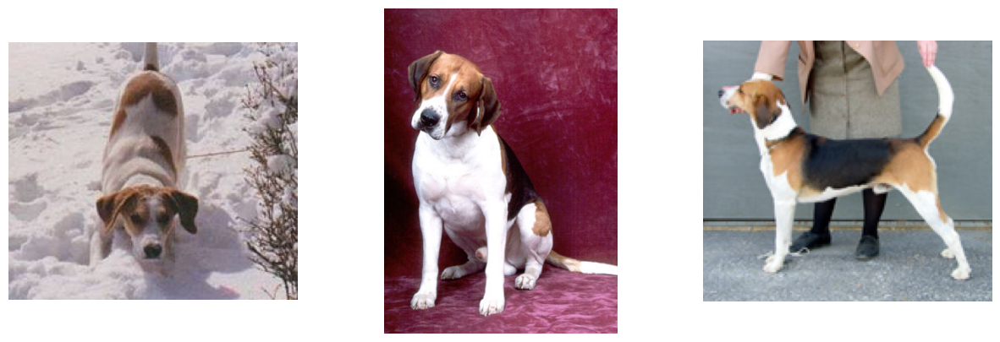

Images de: n02085782-Japanese_spaniel


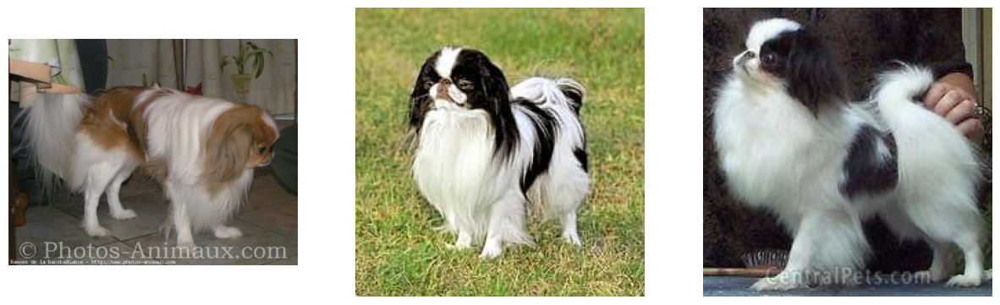

Images de: n02086079-Pekinese


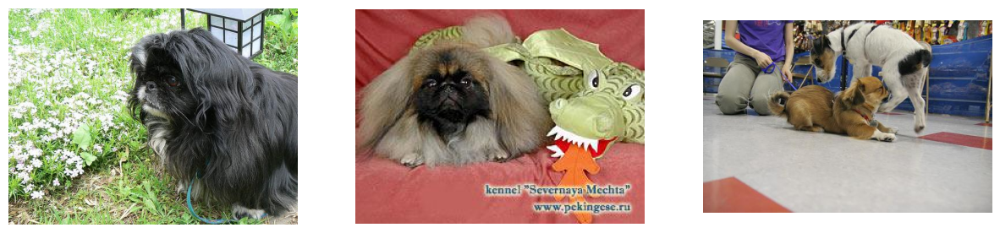

Images de: n02113978-Mexican_hairless


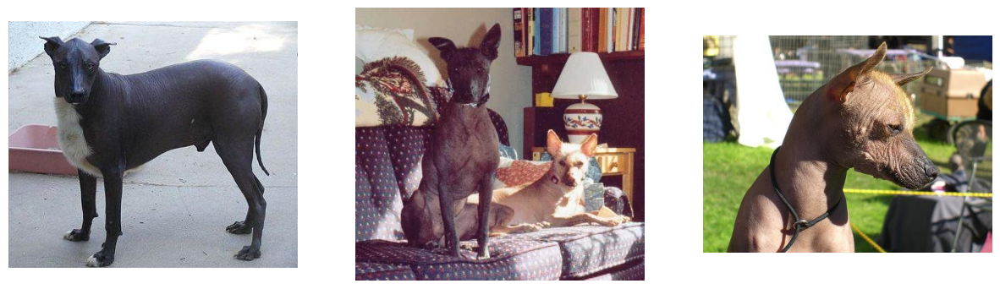

Images de: n02115913-dhole


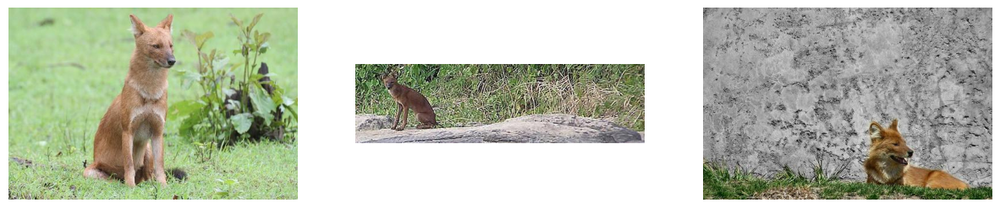

Images de: n02085936-Maltese_dog


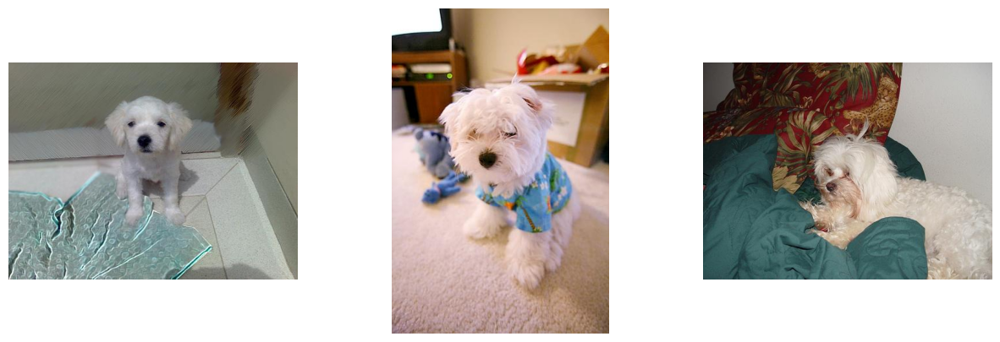

Images de: n02086646-Blenheim_spaniel


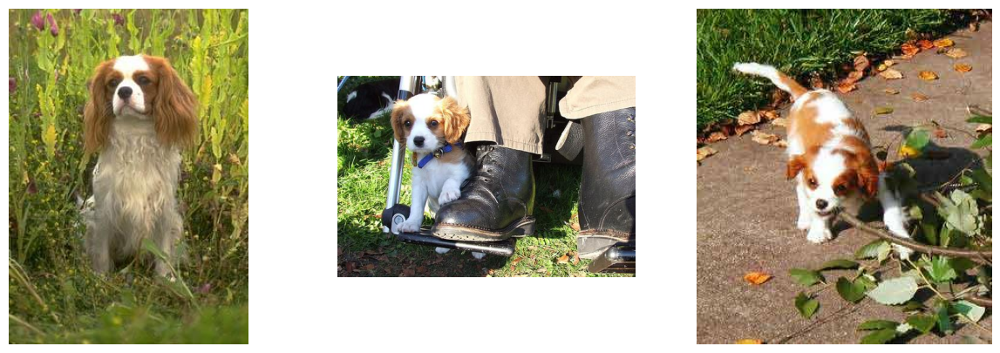

Images de: n02088238-basset


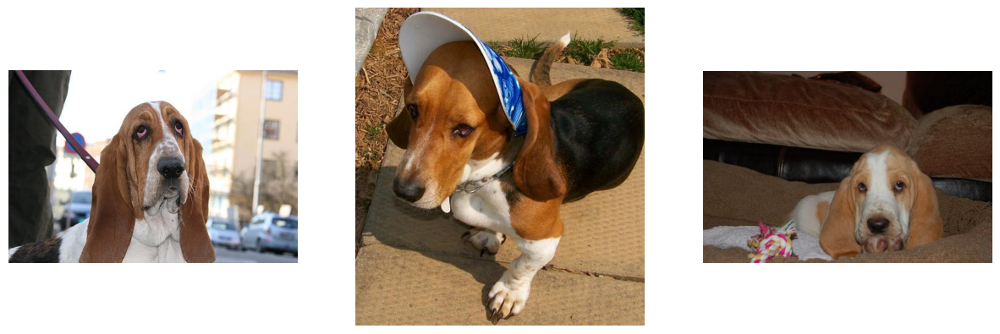

Images de: n02085620-Chihuahua


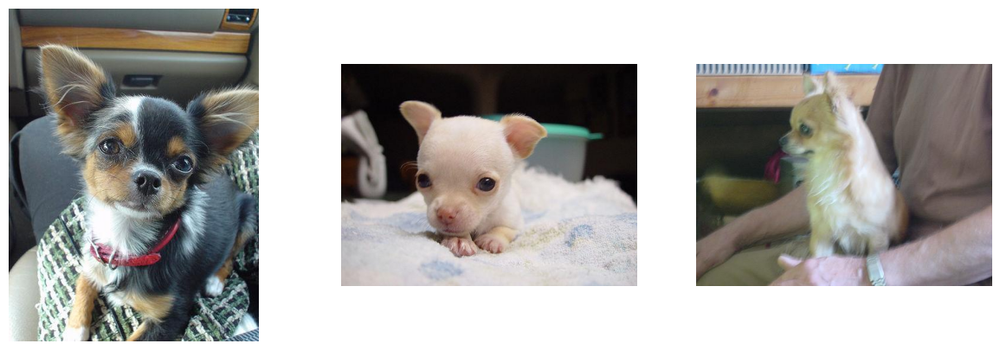

Images de: n02090379-redbone


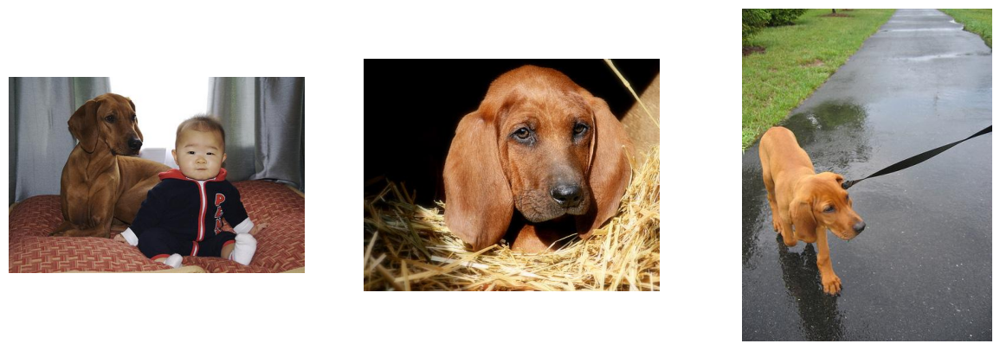

Images de: n02090721-Irish_wolfhound


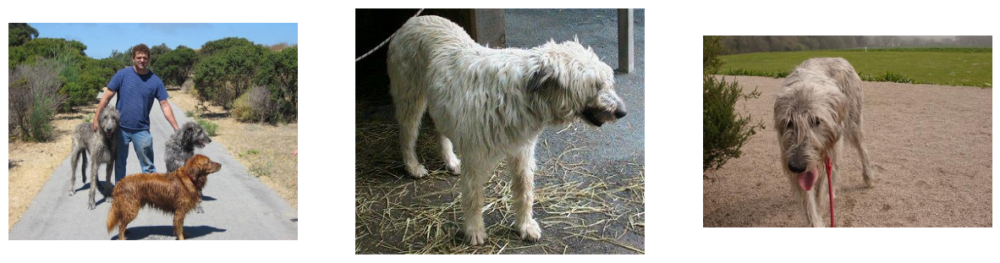

Images de: n02088632-bluetick


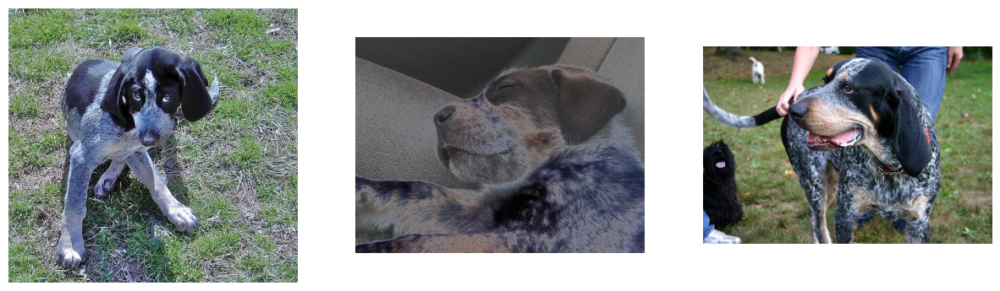

Images de: n02113712-miniature_poodle


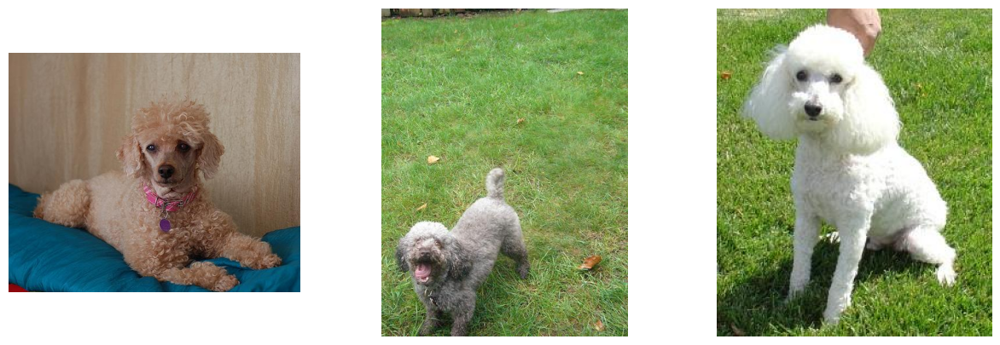

Images de: n02113186-Cardigan


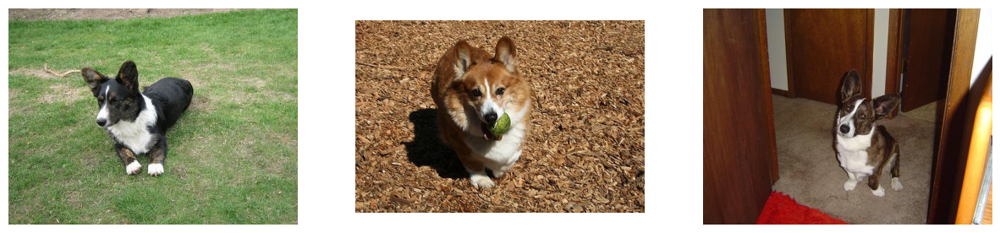

Images de: n02086910-papillon


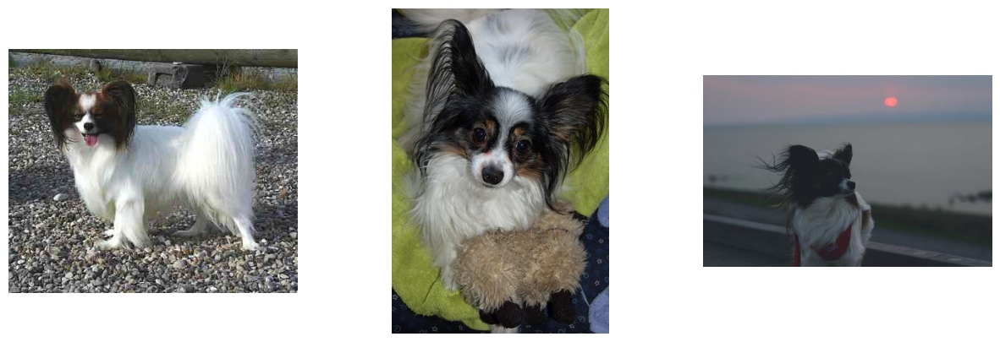

Images de: n02112137-chow


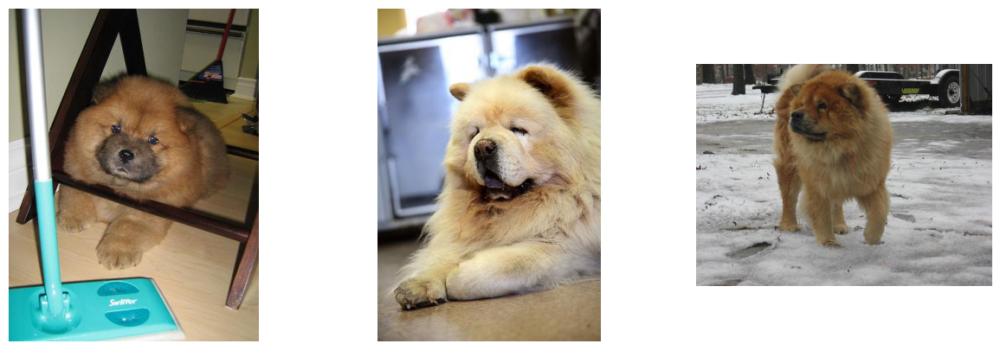

Images de: n02087394-Rhodesian_ridgeback


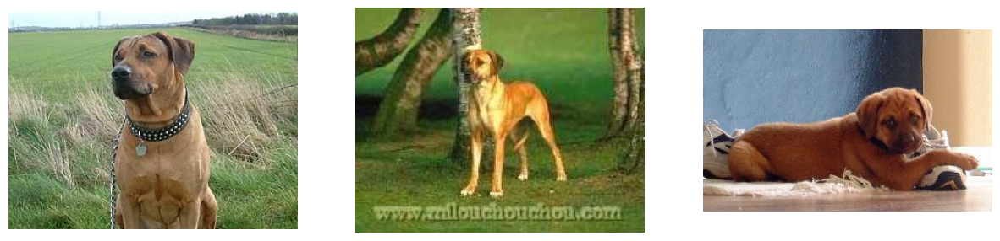

Images de: n02086240-Shih-Tzu


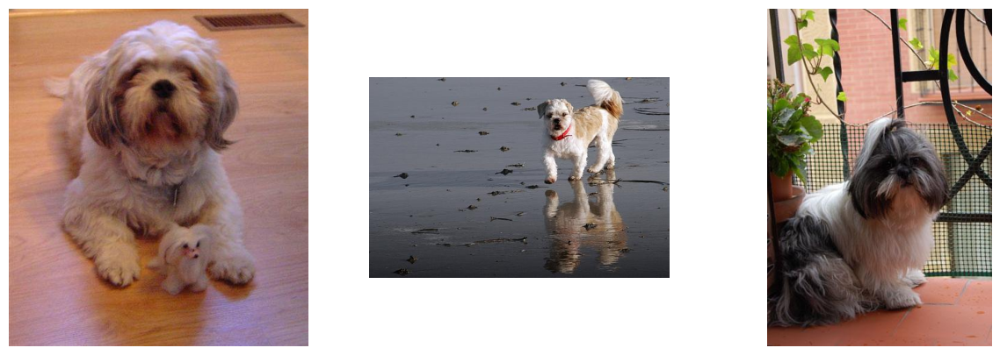

Images de: n02087046-toy_terrier


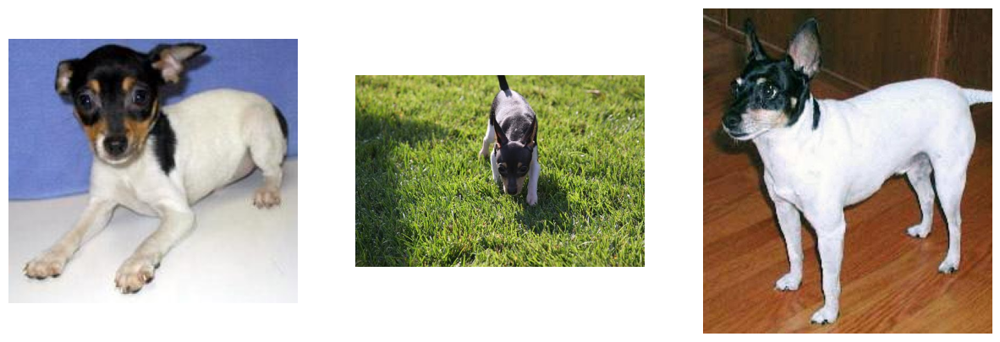

Images de: n02116738-African_hunting_dog


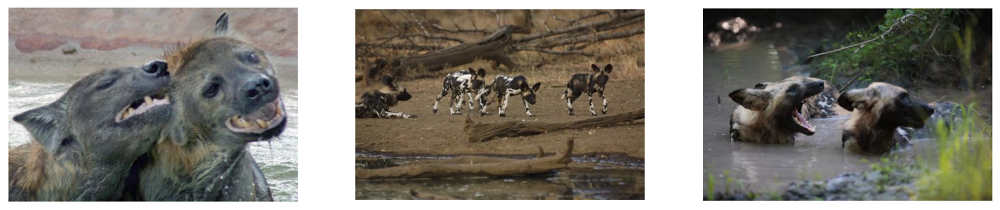

Images de: n02111277-Newfoundland


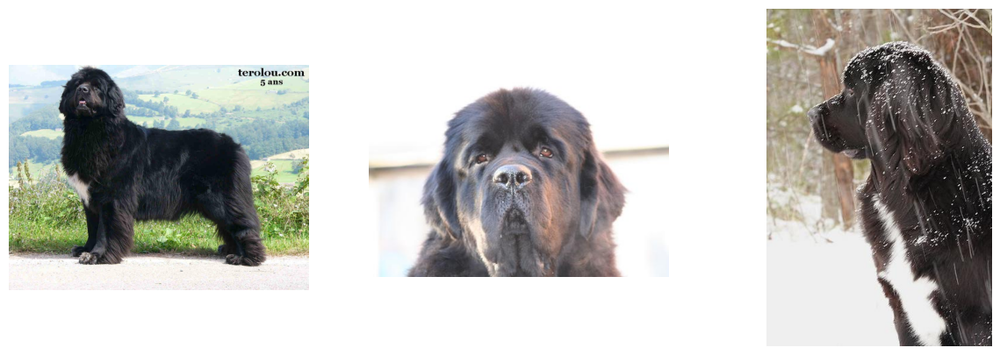

Images de: n02089867-Walker_hound


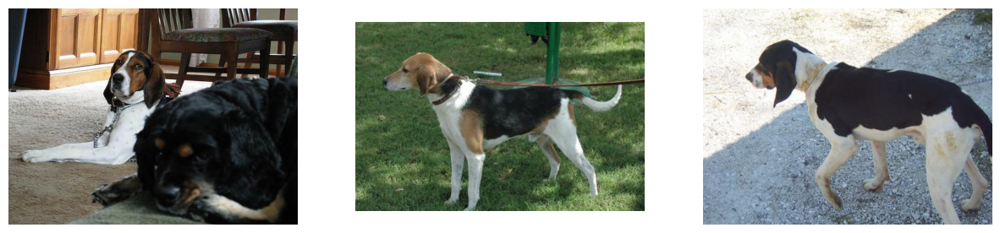

Images de: n02088364-beagle


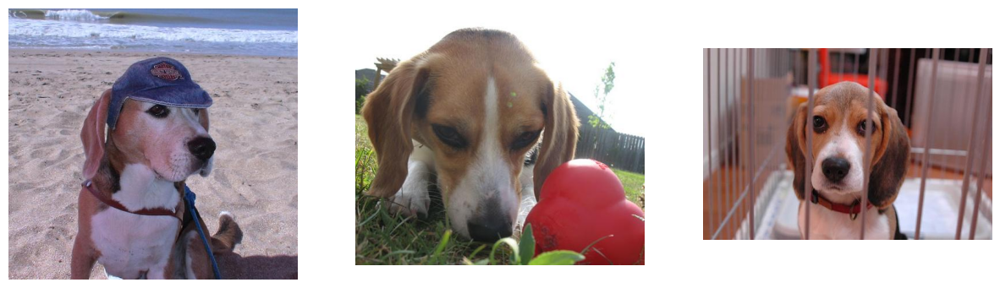

Images de: n02111889-Samoyed


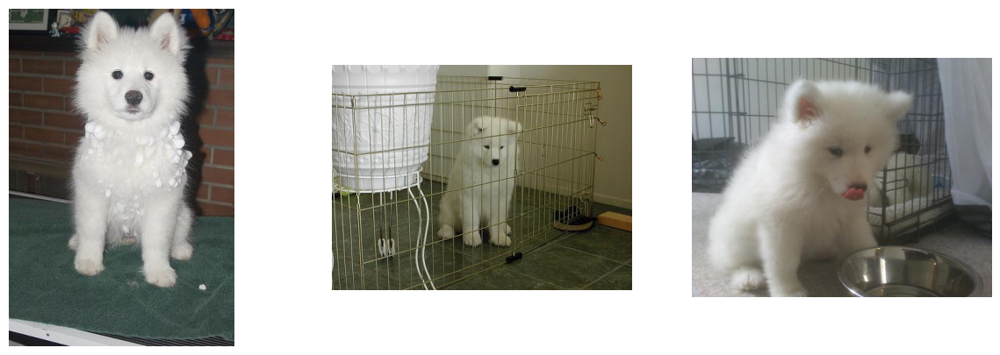

Images de: n02088466-bloodhound


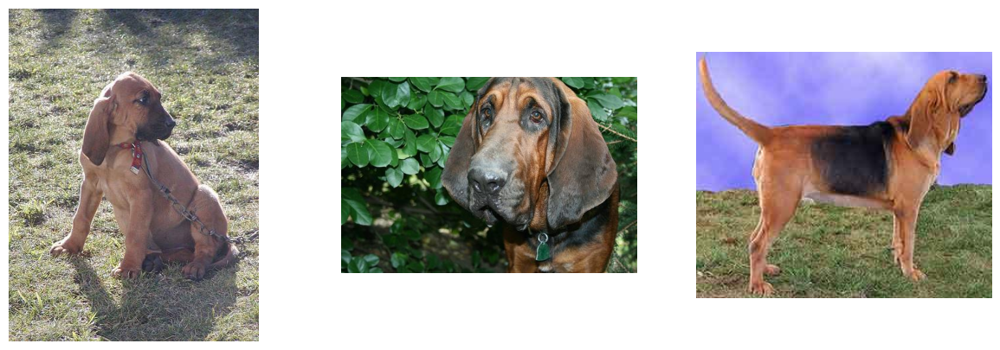

Images de: n02112350-keeshond


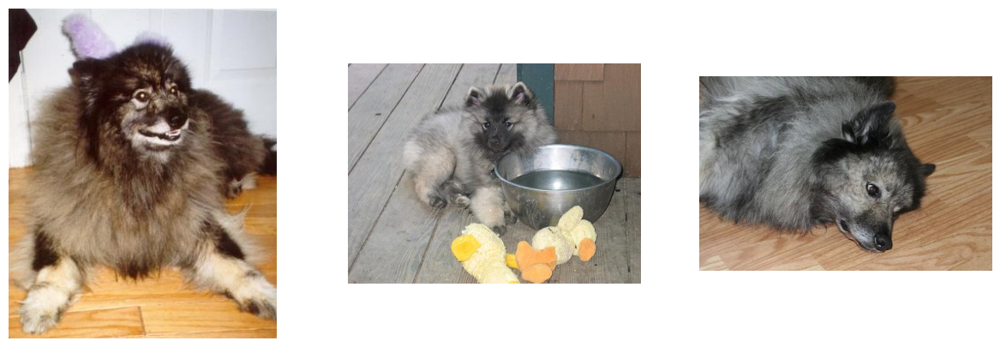

Images de: n02113624-toy_poodle


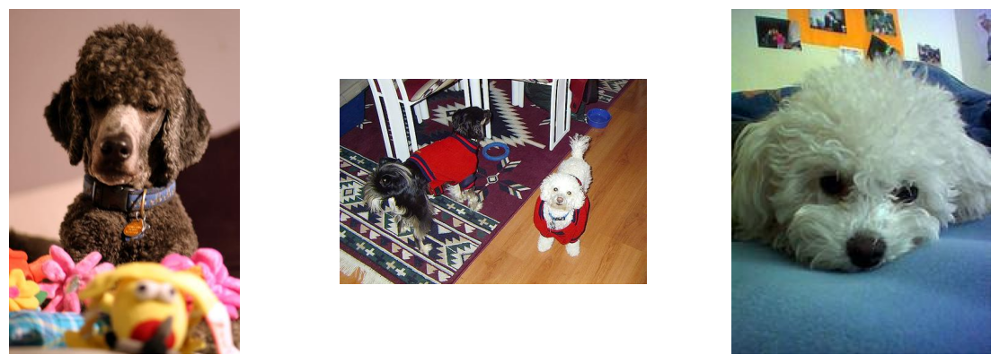

Images de: n02111500-Great_Pyrenees


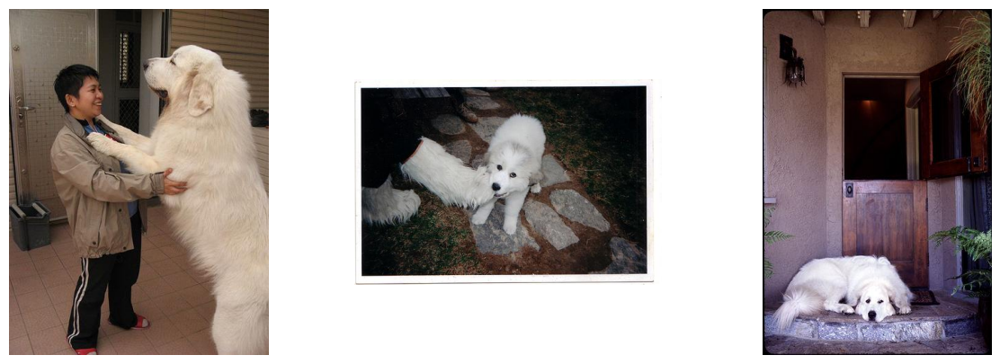

Images de: n02088094-Afghan_hound


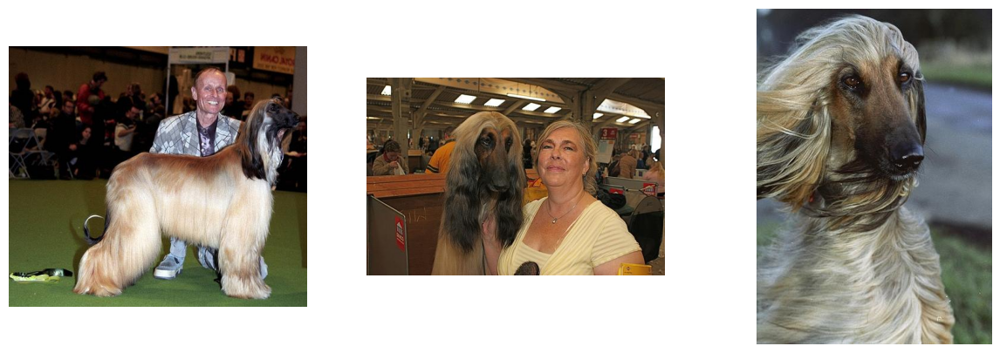

Images de: n02115641-dingo


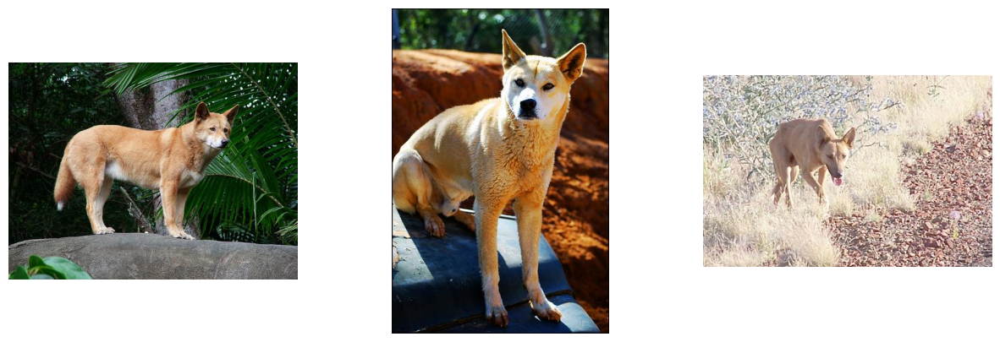

Images de: n02112018-Pomeranian


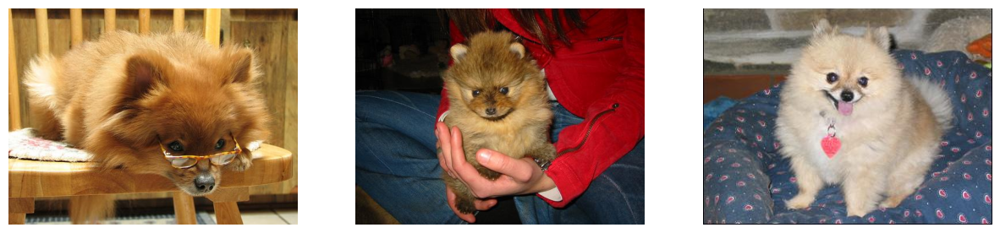

Images de: n02112706-Brabancon_griffon


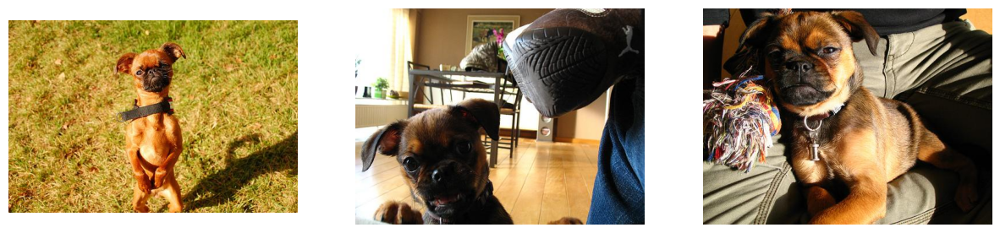

Images de: n02089078-black-and-tan_coonhound


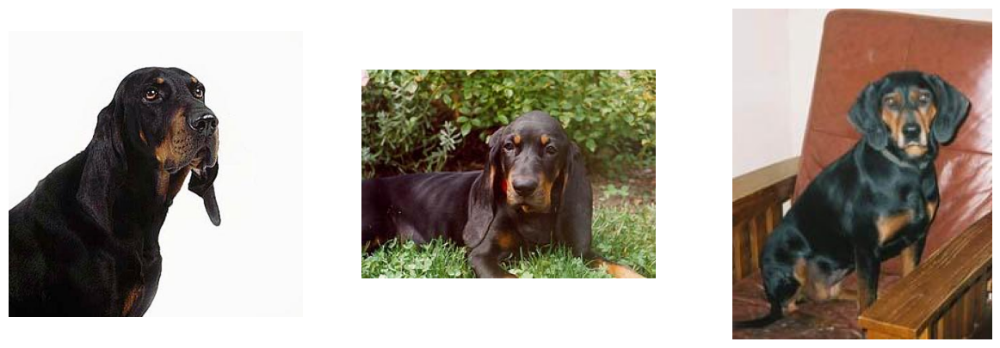

In [14]:
plot_images_from_subfolders(base_dir)

In [15]:
img_dimensions(base_dir)

Analyse des images en: ../data/images/n02090622-borzoi
Dimensions les plus courantes:
Dimension: (333, 500), Fréquence: 18
Dimension: (375, 500), Fréquence: 13
Dimension: (332, 500), Fréquence: 7
Dimension: (500, 375), Fréquence: 7
Dimension: (374, 500), Fréquence: 6
Dimension: (500, 333), Fréquence: 5
Dimension: (334, 500), Fréquence: 3
Dimension: (347, 500), Fréquence: 2
Dimension: (404, 500), Fréquence: 2
Dimension: (500, 357), Fréquence: 2
Dimension: (382, 500), Fréquence: 2
Dimension: (360, 500), Fréquence: 2
Dimension: (387, 500), Fréquence: 2
Dimension: (418, 490), Fréquence: 1
Dimension: (243, 225), Fréquence: 1


Analyse des images en: ../data/images/n02113023-Pembroke
Dimensions les plus courantes:
Dimension: (375, 500), Fréquence: 55
Dimension: (333, 500), Fréquence: 30
Dimension: (500, 375), Fréquence: 20
Dimension: (500, 333), Fréquence: 14
Dimension: (374, 500), Fréquence: 5
Dimension: (500, 334), Fréquence: 3
Dimension: (335, 500), Fréquence: 3
Dimension: (400, 500), Fré

### Normalization & Encoding

In [16]:
processed_dir = Path("../data/processed_images")
data, labels = process_dataset(str(base_dir), str(processed_dir))

print(f"Nombre d'images traitées : {len(data)}")
print(f"Exemple de dimensions : {data[0].shape}")

Classe n02085620-Chihuahua: 152 traitées
Classe n02085782-Japanese_spaniel: 185 traitées
Classe n02085936-Maltese_dog: 252 traitées
Classe n02086079-Pekinese: 149 traitées
Classe n02086240-Shih-Tzu: 214 traitées
Classe n02086646-Blenheim_spaniel: 188 traitées
Classe n02086910-papillon: 196 traitées
Classe n02087046-toy_terrier: 172 traitées
Classe n02087394-Rhodesian_ridgeback: 172 traitées
Classe n02088094-Afghan_hound: 239 traitées
Classe n02088238-basset: 175 traitées
Classe n02088364-beagle: 195 traitées
Classe n02088466-bloodhound: 187 traitées
Classe n02088632-bluetick: 171 traitées
Classe n02089078-black-and-tan_coonhound: 159 traitées
Classe n02089867-Walker_hound: 153 traitées
Classe n02089973-English_foxhound: 157 traitées
Classe n02090379-redbone: 148 traitées
Classe n02090622-borzoi: 151 traitées
Classe n02090721-Irish_wolfhound: 218 traitées
Classe n02111277-Newfoundland: 195 traitées
Classe n02111500-Great_Pyrenees: 213 traitées
Classe n02111889-Samoyed: 218 traitées
Clas

In [17]:
img_dimensions(processed_dir)


Analyse des images en: ../data/processed_images/n02090622-borzoi
Dimensions les plus courantes:
Dimension: (128, 128), Fréquence: 151


Analyse des images en: ../data/processed_images/n02113023-Pembroke
Dimensions les plus courantes:
Dimension: (128, 128), Fréquence: 181


Analyse des images en: ../data/processed_images/n02113799-standard_poodle
Dimensions les plus courantes:
Dimension: (128, 128), Fréquence: 159


Analyse des images en: ../data/processed_images/n02089973-English_foxhound
Dimensions les plus courantes:
Dimension: (128, 128), Fréquence: 157


Analyse des images en: ../data/processed_images/n02085782-Japanese_spaniel
Dimensions les plus courantes:
Dimension: (128, 128), Fréquence: 185


Analyse des images en: ../data/processed_images/n02086079-Pekinese
Dimensions les plus courantes:
Dimension: (128, 128), Fréquence: 149


Analyse des images en: ../data/processed_images/n02113978-Mexican_hairless
Dimensions les plus courantes:
Dimension: (128, 128), Fréquence: 155


Analy

Images de: n02090622-borzoi


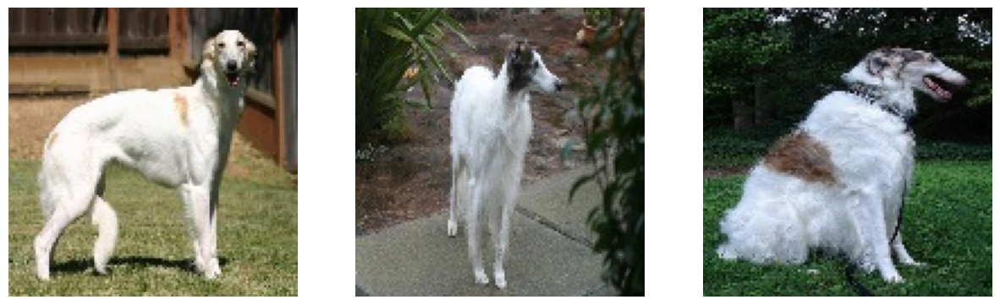

Images de: n02113023-Pembroke


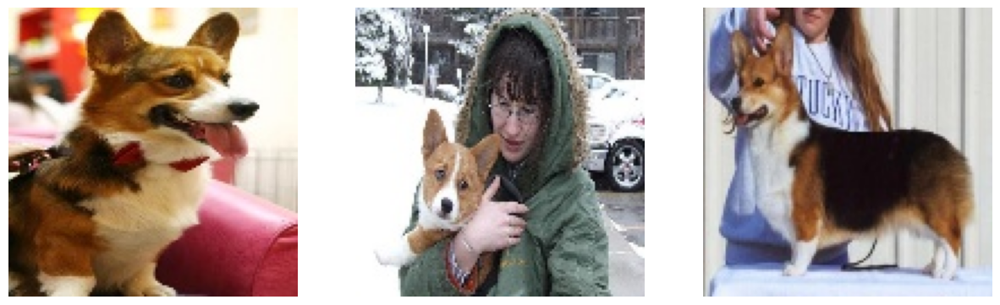

Images de: n02113799-standard_poodle


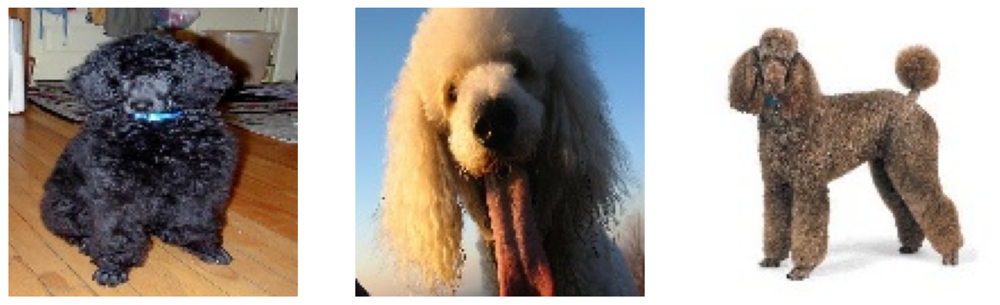

Images de: n02089973-English_foxhound


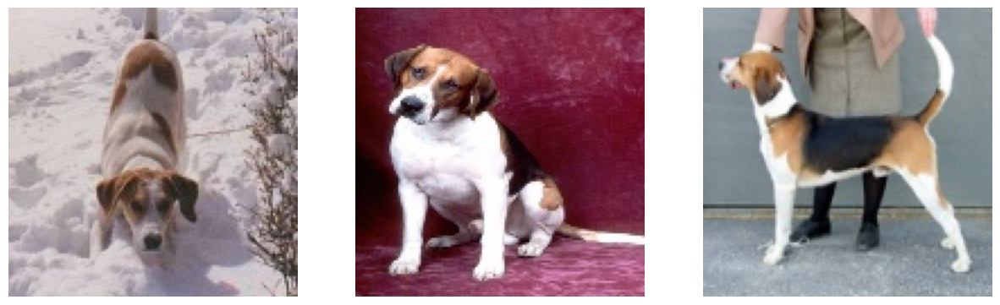

Images de: n02085782-Japanese_spaniel


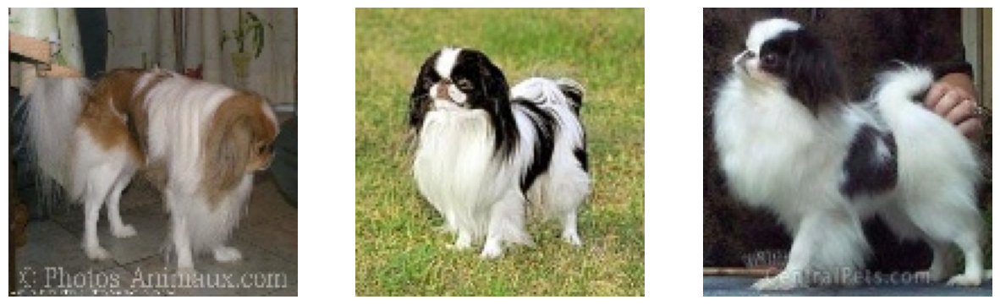

Images de: n02086079-Pekinese


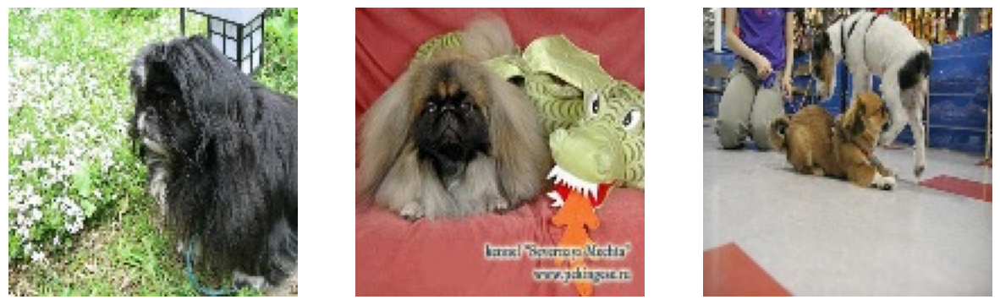

Images de: n02113978-Mexican_hairless


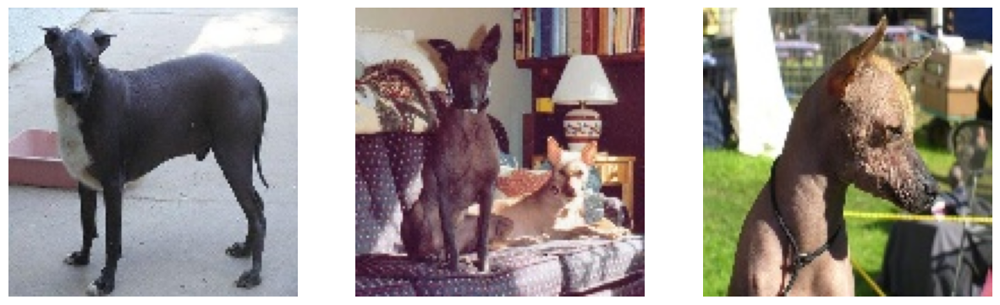

Images de: n02115913-dhole


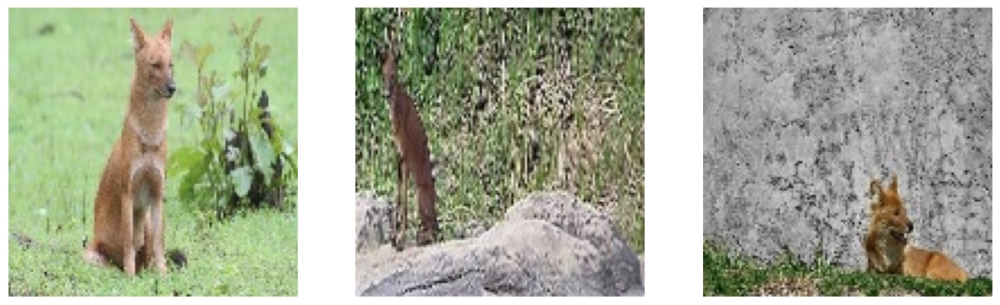

Images de: n02085936-Maltese_dog


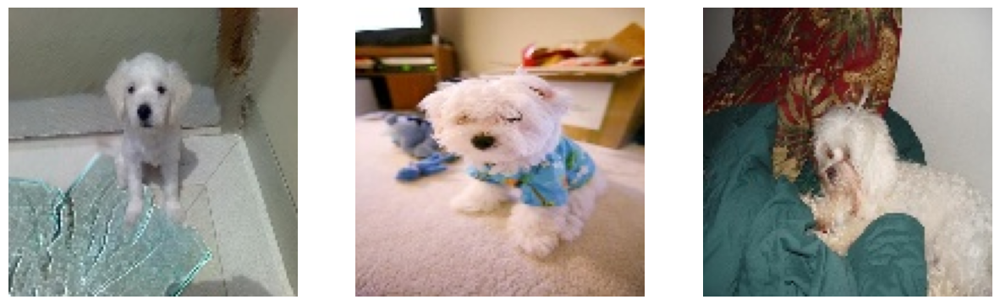

Images de: n02086646-Blenheim_spaniel


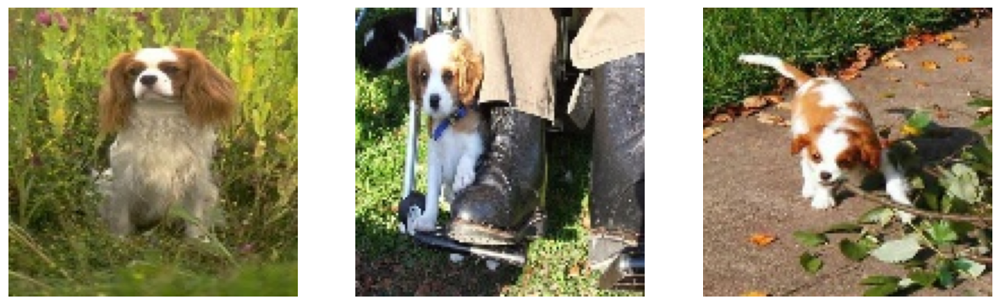

Images de: n02088238-basset


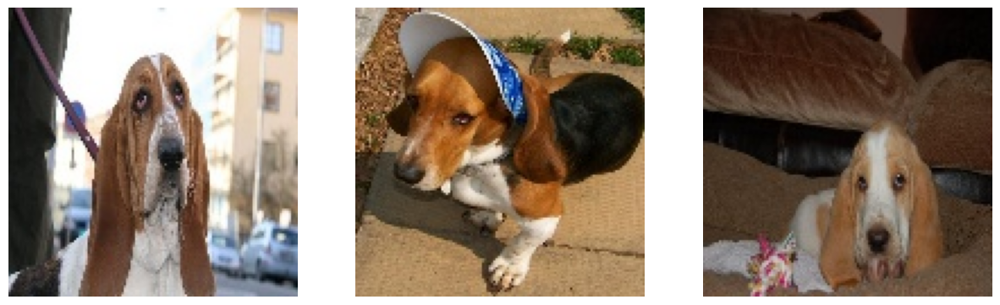

Images de: n02085620-Chihuahua


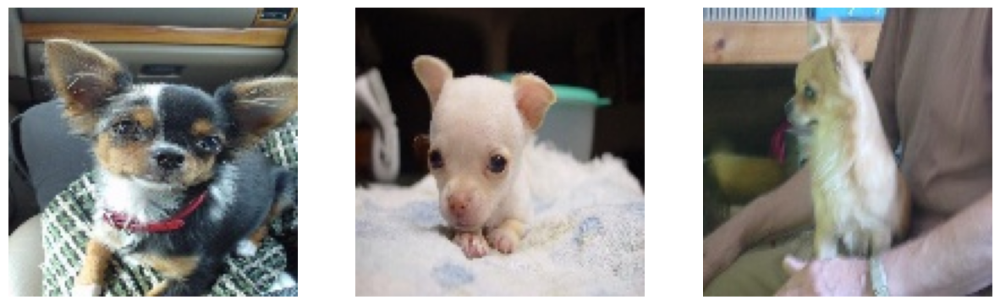

Images de: n02090379-redbone


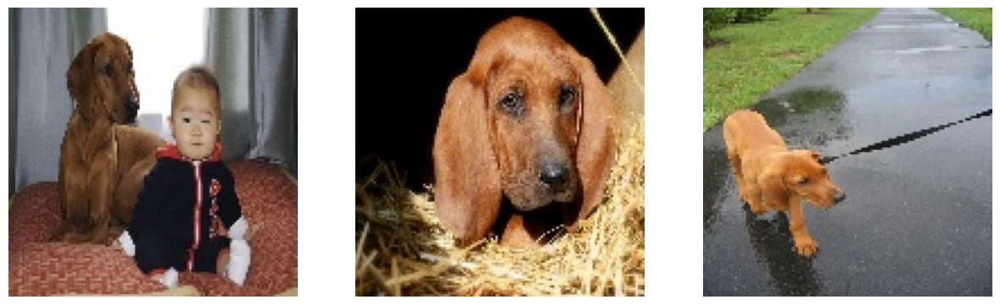

Images de: n02090721-Irish_wolfhound


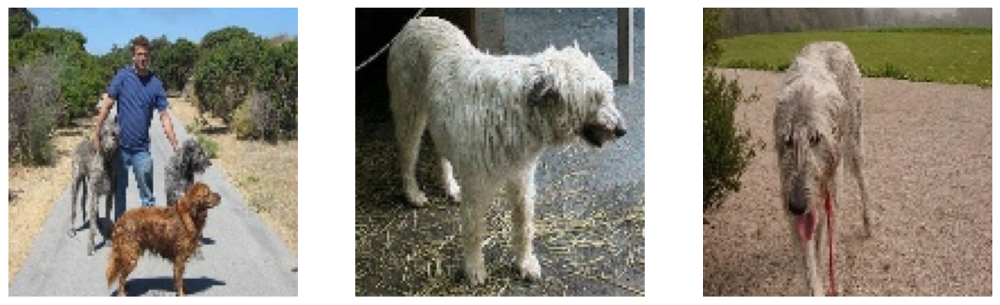

Images de: n02088632-bluetick


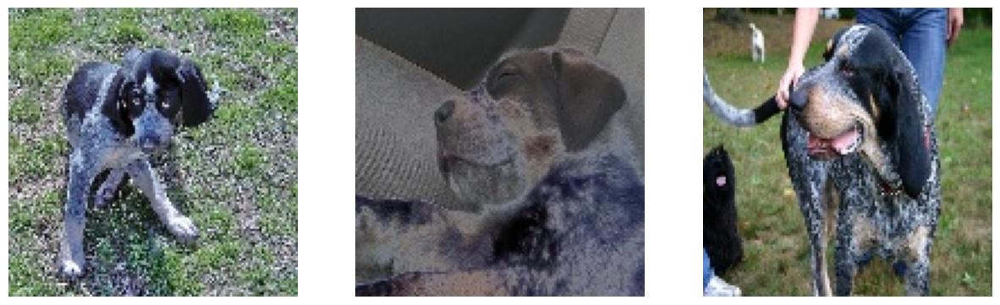

Images de: n02113712-miniature_poodle


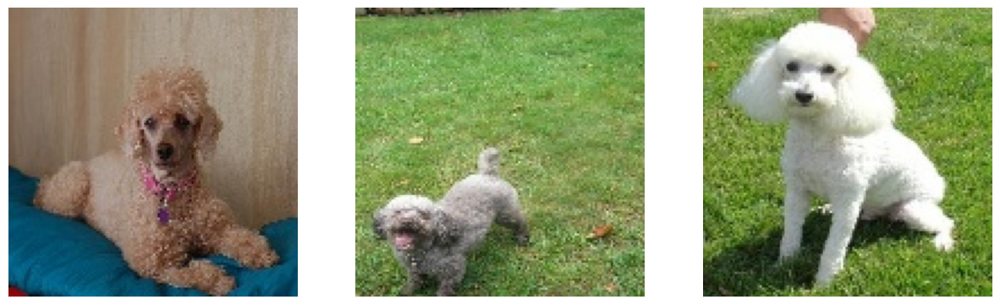

Images de: n02113186-Cardigan


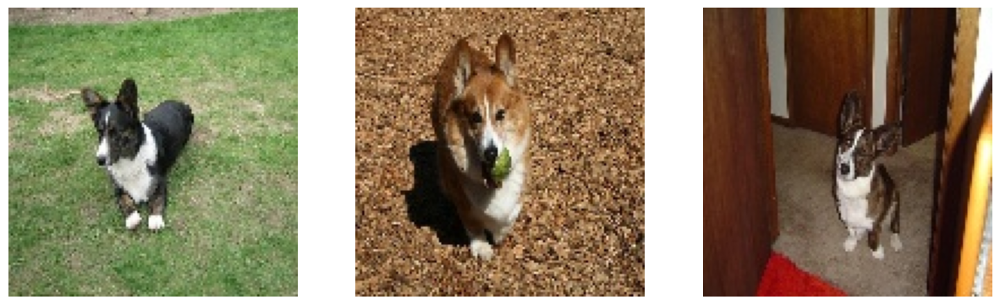

Images de: n02086910-papillon


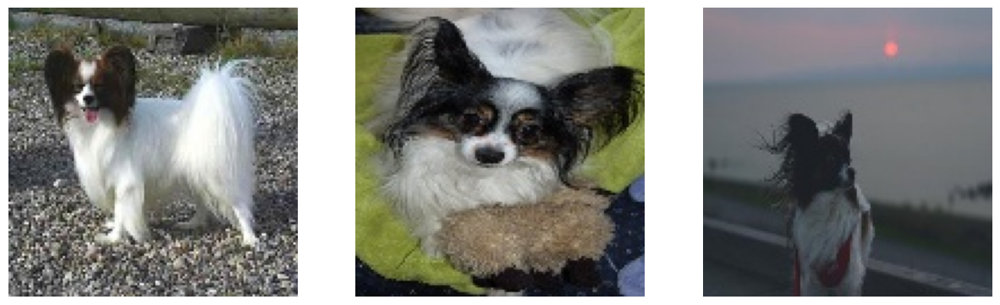

Images de: n02112137-chow


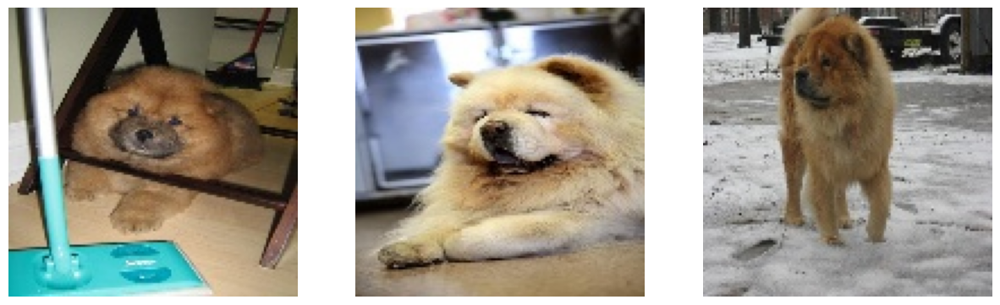

Images de: n02087394-Rhodesian_ridgeback


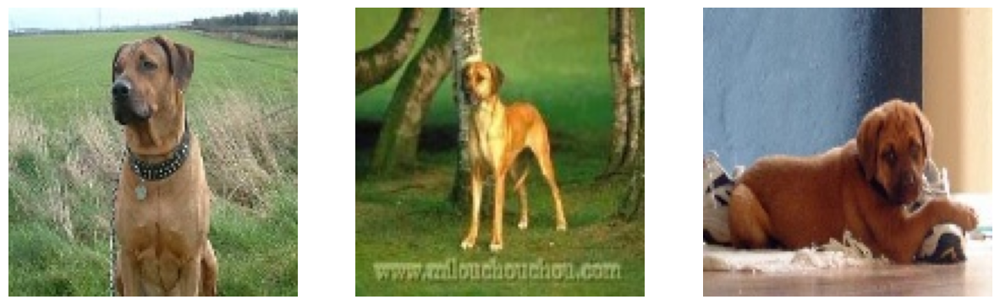

Images de: n02086240-Shih-Tzu


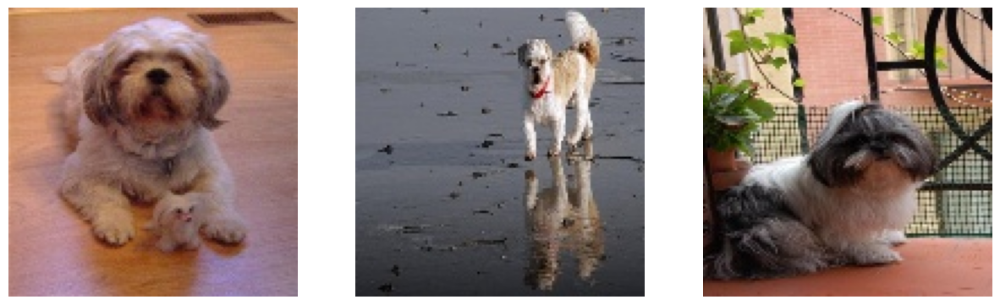

Images de: n02087046-toy_terrier


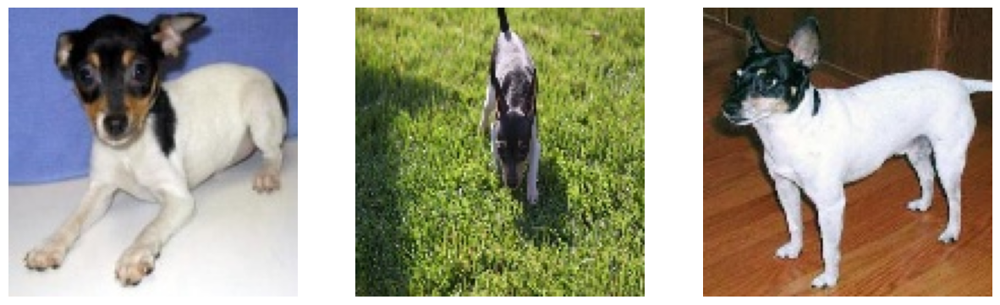

Images de: n02116738-African_hunting_dog


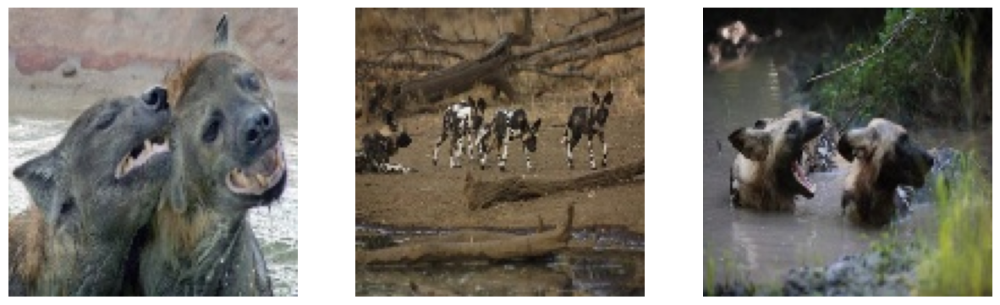

Images de: n02111277-Newfoundland


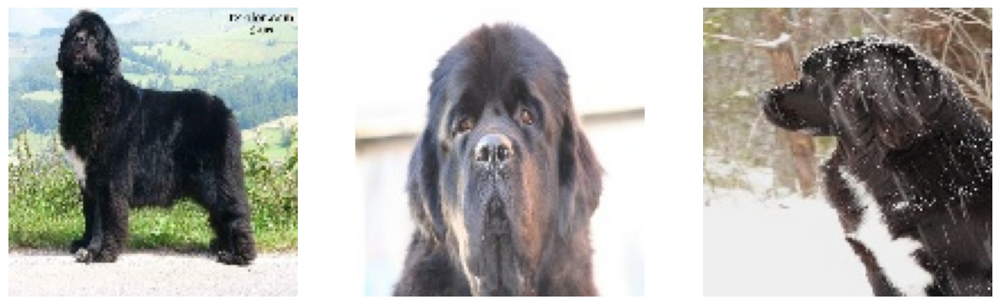

Images de: n02089867-Walker_hound


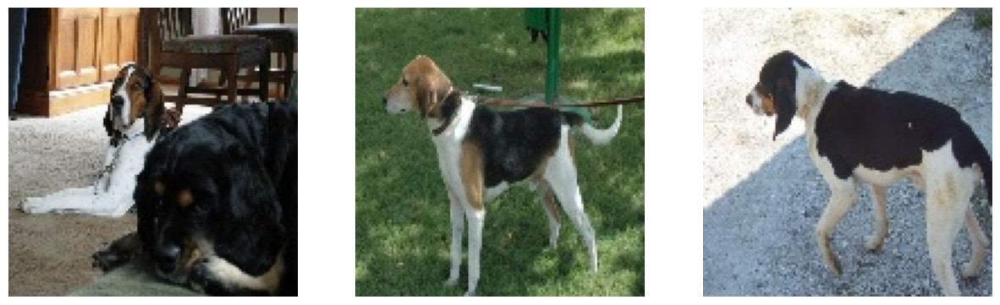

Images de: n02088364-beagle


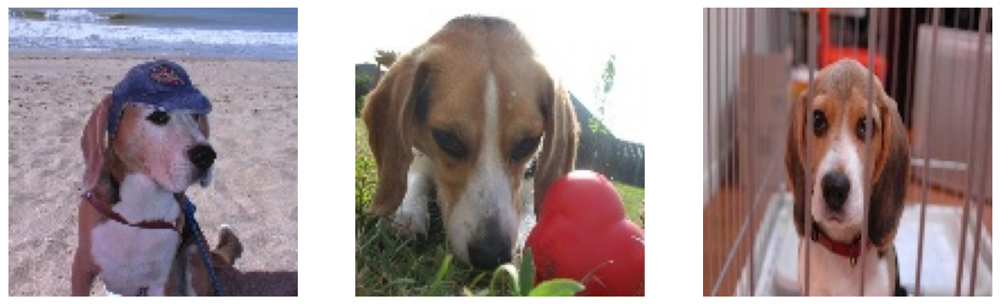

Images de: n02111889-Samoyed


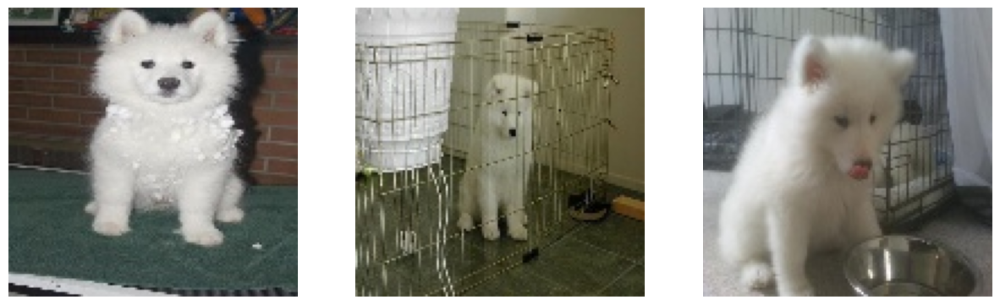

Images de: n02088466-bloodhound


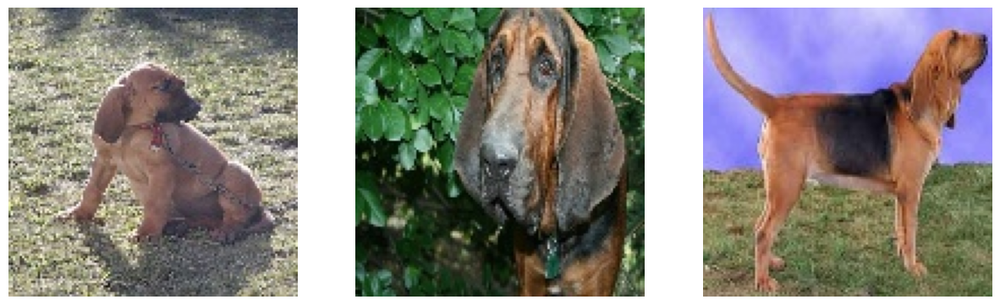

Images de: n02112350-keeshond


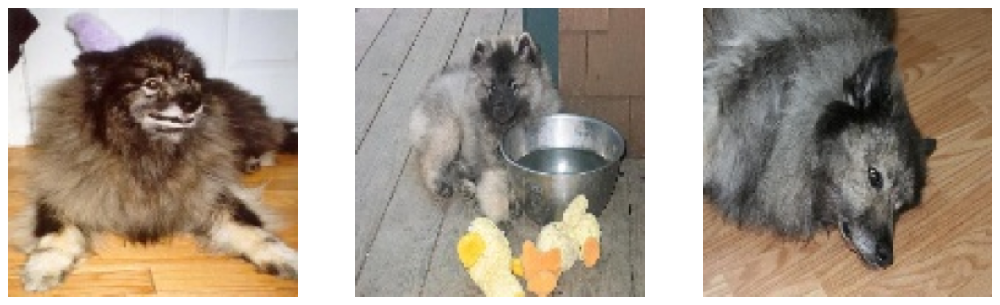

Images de: n02113624-toy_poodle


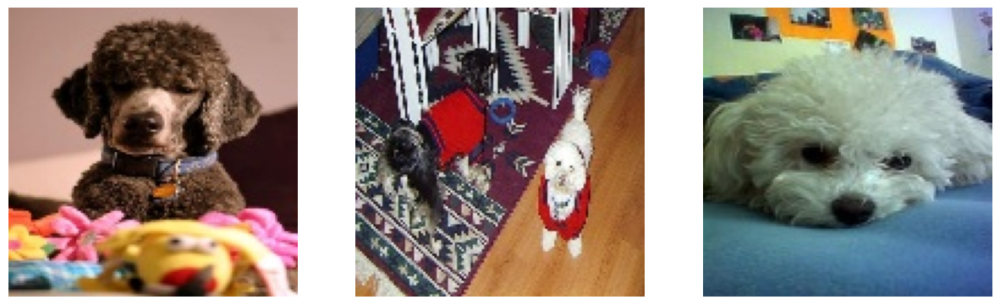

Images de: n02111500-Great_Pyrenees


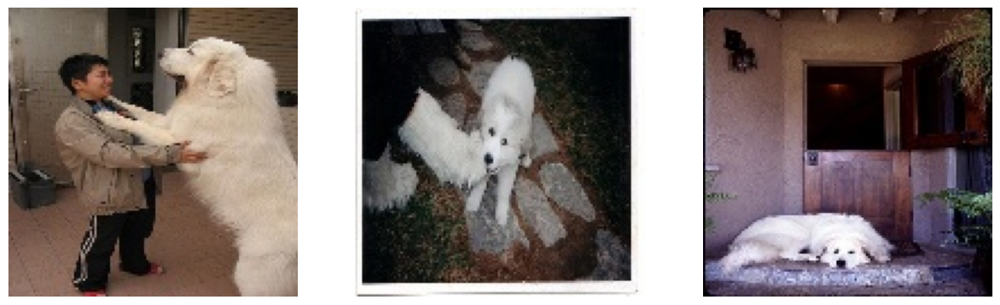

Images de: n02088094-Afghan_hound


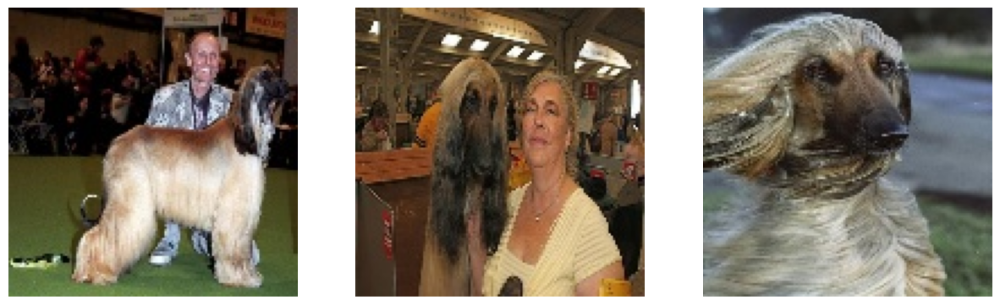

Images de: n02115641-dingo


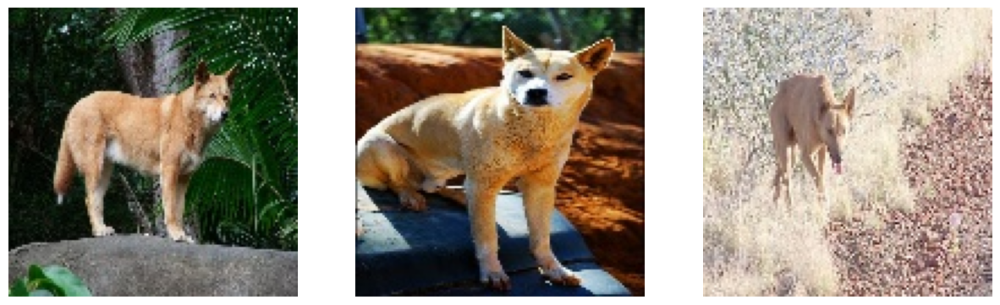

Images de: n02112018-Pomeranian


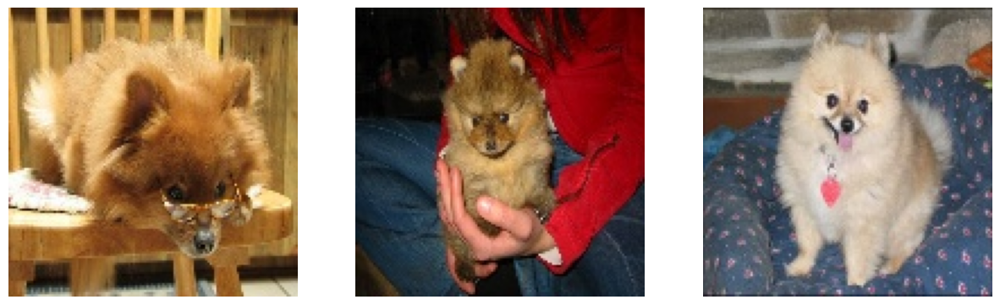

Images de: n02112706-Brabancon_griffon


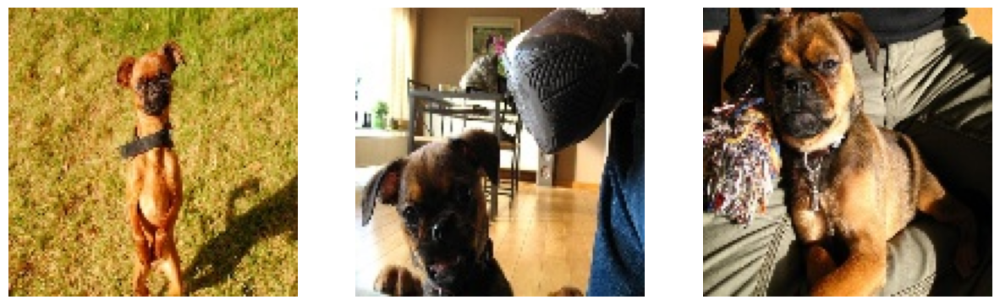

Images de: n02089078-black-and-tan_coonhound


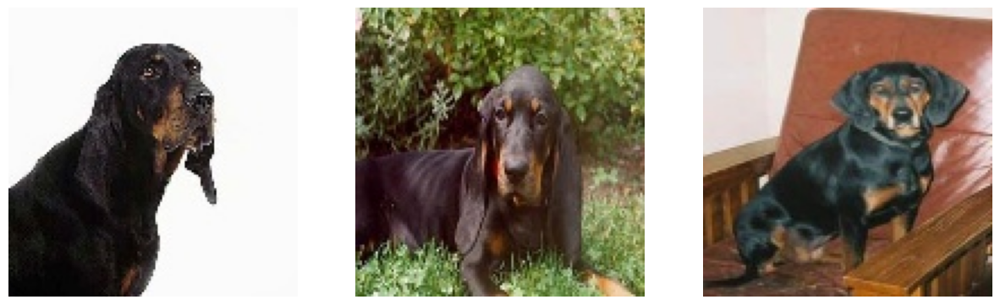

In [18]:
plot_images_from_subfolders(processed_dir)

In [19]:
data = np.array(data, dtype="float32") / 255.0
labels = np.array(labels)
mlb = LabelBinarizer()
labels = mlb.fit_transform(labels)

print(labels[0])

[1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


### Enrichissement du jeu de données par augmentation d’images 

In [20]:
final_imgs_data, final_labels_data = increase_dataset(data, labels)

In [21]:
print("Size before augmentation : ",data.shape[0])
print("Size After augmentation : ",final_imgs_data.shape[0])

Size before augmentation :  6416
Size After augmentation :  12832


### Séparation des données 

In [22]:
x_train, x_val, x_test, y_train, y_val, y_test = split_data(final_imgs_data, final_labels_data)

In [23]:
classes = np.unique(final_labels_data)

# Vérifier la distribution des classes dans les ensembles d'entraînement, de validation et de test
train_class_distribution = check_class_distribution(y_train, classes)
val_class_distribution = check_class_distribution(y_val, classes)
test_class_distribution = check_class_distribution(y_test, classes)

print("🔹 Distribution des classes dans l'ensemble d'entraînement :", train_class_distribution)
print("🔹 Distribution des classes dans l'ensemble de validation :", val_class_distribution)
print("🔹 Distribution des classes dans l'ensemble de test :", test_class_distribution)

🔹 Distribution des classes dans l'ensemble d'entraînement : {0: 176, 1: 235}
🔹 Distribution des classes dans l'ensemble de validation : {0: 55, 1: 63}
🔹 Distribution des classes dans l'ensemble de test : {0: 73, 1: 72}


## 🧠🔧 Chargement et Configuration des Modèles de Deep Learning

### 📈 Définition de eval_metrics

In [24]:
def eval_metrics(y_true, y_pred, y_pred_proba):
    """
    Calcule un ensemble complet de métriques d'évaluation pour une tâche de classification multiclasse.

    Arguments :
    - y_true : np.array, étiquettes réelles (entiers ou indices de classes).
    - y_pred : np.array, étiquettes prédites (indices de classes).
    - y_pred_proba : np.array, probabilités prédites par le modèle pour chaque classe (shape: [n_samples, n_classes]).

    Retour :
    - dict contenant les métriques suivantes :
        * accuracy : exactitude globale.
        * precision : précision moyenne pondérée (weighted).
        * recall : rappel moyen pondéré (weighted).
        * log_loss : perte logarithmique.
        * roc_auc : dictionnaire des AUC ROC par classe.
        * mean_roc_auc : moyenne des AUC ROC sur toutes les classes.
    """
    # Calcul des métriques classiques
    accuracy = accuracy_score(y_true, y_pred)
    precision = precision_score(y_true, y_pred, average='weighted', zero_division=0)
    recall = recall_score(y_true, y_pred, average='weighted', zero_division=0)
    logloss = log_loss(y_true, y_pred_proba)

    # Binarisation des labels pour calcul ROC AUC (One-vs-Rest)
    n_classes = y_pred_proba.shape[1]
    y_true_bin = label_binarize(y_true, classes=range(n_classes))

    roc_auc = {}
    for i in range(n_classes):
        fpr, tpr, _ = roc_curve(y_true_bin[:, i], y_pred_proba[:, i])
        roc_auc[i] = auc(fpr, tpr)

    mean_roc_auc = np.mean(list(roc_auc.values()))

    return {
        'accuracy': accuracy,
        'precision': precision,
        'recall': recall,
        'log_loss': logloss,
        'roc_auc': roc_auc,
        'mean_roc_auc': mean_roc_auc
    }

### ⚙️ Définition des params

In [25]:
ESTIMATOR_PARAMS = {
    "VGG16": {
        "estimator": VGG16,
        "params": VGG16_CONFIG
    },
    "MobileNetV2": {
        "estimator": MobileNetV2,
        "params": MOBILENETV2_CONFIG
    },
    "DenseNet121": {
        "estimator": DenseNet121,
        "params": DENSENET_CONFIG
    }
}

In [26]:
for model_name, model_configs in ESTIMATOR_PARAMS.items():
    estimator = model_configs["estimator"]
    params = model_configs["params"]

    print(f"Nom du modèle : {model_name}")
    print(f"Estimateur : {estimator}")
    print(f"Paramètres : {params}")
    print("=" * 40)

Nom du modèle : VGG16
Estimateur : <function VGG16 at 0x19f5e94e0>
Paramètres : {'input_shape': (128, 128, 3), 'num_classes': 36, 'learning_rate': 1e-05, 'batch_size': 32, 'pretrained': True, 'epochs': 50}
Nom du modèle : MobileNetV2
Estimateur : <function MobileNetV2 at 0x19f5beca0>
Paramètres : {'input_shape': (128, 128, 3), 'num_classes': 36, 'learning_rate': 0.0001, 'patience': 5, 'epochs': 50}
Nom du modèle : DenseNet121
Estimateur : <function DenseNet121 at 0x19f58bec0>
Paramètres : {'num_classes': 36, 'dropout_rate': 0.5, 'min_lr': 1e-08, 'monitor': 'val_accuracy', 'factor': 0.15, 'patience': 6, 'learning_rate': 0.001, 'batch_size': 64, 'epochs': 50}


### Configuration du MLFLOW

In [27]:
# Configurer logging simple
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Définir le registre local (fichier SQLite)
local_registry = "sqlite:///mlruns.db"
print(f"Running local model registry={local_registry}")
mlflow.set_tracking_uri(local_registry)

# Créer une expérience
exp_name = "garbage_classification"
experiment = mlflow.get_experiment_by_name(exp_name)
if not experiment:
    experiment_id = mlflow.create_experiment(exp_name)
else:
    experiment_id = experiment.experiment_id

logger.info(f"Experiment id: {experiment_id}")

Running local model registry=sqlite:///mlruns.db


2025/07/29 12:23:00 INFO mlflow.store.db.utils: Creating initial MLflow database tables...
2025/07/29 12:23:00 INFO mlflow.store.db.utils: Updating database tables
INFO  [alembic.runtime.migration] Context impl SQLiteImpl.
INFO  [alembic.runtime.migration] Will assume non-transactional DDL.
INFO  [alembic.runtime.migration] Context impl SQLiteImpl.
INFO  [alembic.runtime.migration] Will assume non-transactional DDL.


#### Fonction d'exécution des expérimentations

In [28]:
def run_experiment(experiment_id):
    global x_train, x_val, x_test, y_train, y_val, y_test, data, labels, class_names

    for model_name, model_configs in ESTIMATOR_PARAMS.items():
        logger.info(f"Starting training for model: {model_name}")

        params = model_configs["params"]
        epoch_number = params.get("epochs", 50)

        with mlflow.start_run(
            run_name=f"{model_name}_{datetime.now().strftime('%Y%m%d_%H%M%S')}",
            experiment_id=experiment_id,
            tags={"version": "v1", "priority": "P1"},
            description=f"{model_name} for garbage classification",
        ) as run:
            
            mlflow.log_param("model", model_name)
            mlflow.log_params(params)

            if model_name == "DenseNet121":
                model, x_train_d, x_val_d, x_test_d, y_train_d, y_val_d, y_test_d = build_densenet_model(params, data, labels)
                history, training_params = train_densenet_model(model, params, x_train_d, y_train_d, x_val_d, y_val_d, model_path="registered_models")

                y_pred_proba = model.predict(x_test_d)
                y_pred = np.argmax(y_pred_proba, axis=1)
                y_true = np.argmax(y_test_d, axis=1) if y_test_d.ndim == 2 else y_test_d

                metrics = eval_metrics(y_true, y_pred, y_pred_proba)

                signature = infer_signature(x_test_d, y_pred_proba)
                mlflow.keras.log_model(model, artifact_path="model", signature=signature, registered_model_name=model_name)

            elif model_name == "MobileNetV2":
                patience = params.get("patience", 5)
                model, _ = create_mobilenetv2_model(params["input_shape"], params["num_classes"], params["learning_rate"])
                history = train_mobilenetv2_model(model, x_train, y_train, x_val, y_val, epoch_number, patience)

                results, y_pred_proba = test_mobilenetv2_model(model, x_test, y_test, class_names)
                y_pred = [class_names.index(pred) for pred, _ in results]
                y_true = [class_names.index(real) for _, real in results]

                metrics = eval_metrics(y_true, y_pred, y_pred_proba)

                signature = infer_signature(x_test, y_pred_proba)
                mlflow.keras.log_model(model, artifact_path="model", signature=signature, registered_model_name=model_name)

            elif model_name == "VGG16":
                model = create_vgg16_model(params)
                train_loader, val_loader, test_loader = create_data_loaders_for_vgg16(x_train, x_val, x_test, y_train, y_val, y_test, params)
                trained_model = train_vgg16_model(model, train_loader, val_loader, params)

                y_pred_proba, metrics = test_model_vgg16(trained_model, test_loader)

                signature = infer_signature(x_test, y_pred_proba)
                mlflow.pytorch.log_model(trained_model, artifact_path="model", signature=signature, registered_model_name=model_name)

            # Log metrics in MLflow
            mlflow.log_metric("test_accuracy", metrics['accuracy'])
            mlflow.log_metric("test_precision", metrics['precision'])
            mlflow.log_metric("test_recall", metrics['recall'])
            mlflow.log_metric("test_log_loss", metrics['log_loss'])
            mlflow.log_metric("test_mean_roc_auc", metrics['mean_roc_auc'])

            for class_index, class_roc_auc in metrics['roc_auc'].items():
                mlflow.log_metric(f"test_roc_auc_class_{class_index}", class_roc_auc)

            
            output_dir = "outputs"
            if not os.path.exists(output_dir):
                os.makedirs(output_dir)
            with open(f"{output_dir}/test.txt", "w") as f:
                f.write("Logs saved successfully in MLflow!")

            mlflow.log_artifacts(output_dir)
            shutil.rmtree(output_dir)

            print(f"Model run logged to MLflow with run_id: {run.info.run_id}")

In [ ]:
run_experiment(experiment_id)

#### Accéder à l'interface MLflow UI depuis Jupyter

In [ ]:
!mlflow ui --port 5000

#### <span style="color:#0099cc">Puis ouvre dans le navigateur :</span>

http://localhost:5000